In [1]:
import xarray as xr
xr.set_options(display_style='html')
import intake
import cftime
import matplotlib.pyplot as plt
import numpy as np
from netCDF4 import Dataset
from matplotlib.colors import LogNorm
import cartopy.crs as ccrs
import cartopy
import matplotlib.path as mpath
import sys
sys.path.append('/home/jovyan/Tjaernoe2022-group5/notebooks/Remy/')
from functions import compute_ivt,to_nc
from matplotlib import rc,animation
from matplotlib.animation import FuncAnimation
from IPython import display
import cartopy as cy
import os
from matplotlib.colors import TwoSlopeNorm

In [2]:
def circle_for_polar_map(axes):
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    axes.set_boundary(circle, transform=axes.transAxes)

In [3]:
data_dir = '/home/jovyan/Tjaernoe2022-group5/data'

In [4]:
aod_ev = xr.open_dataset(os.path.join(data_dir,'CAMS_MOSAIC_event3h_AOD.nc'))
aod_month = xr.open_dataset(os.path.join(data_dir,'CAMS_monthly_AOD.nc'))

In [11]:
hus_ds = xr.open_dataset(os.path.join(data_dir, 'ERA5_hourly_ivt_16_q.nc'))

In [13]:
v_ds = xr.open_dataset(os.path.join(data_dir, 'ERA5_hourly_ivt_16_v.nc'))

In [30]:
ivt = compute_ivt(hus_ds.q, v_ds.v, (v_ds.level*100).astype(float))

ValueError: x must be one of None, 'latitude', 'longitude', 'time'

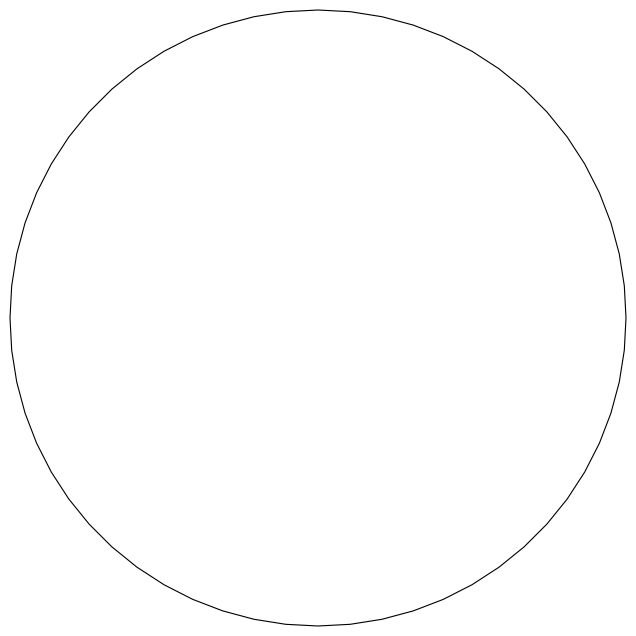

In [33]:
ds_polar_plot(ivt.squeeze())

In [5]:
aod_ev_arctic = aod_ev.sel(latitude=slice(90,50))
aod_month_arctic = aod_month.sel(latitude=slice(90,50))

In [6]:
aod_month = aod_month.mean(dim='time')

In [7]:
aod_anom = aod_ev_arctic-aod_month

In [8]:
aod_anom

<xarray.Dataset>
Dimensions:    (latitude: 54, longitude: 480, time: 81)
Coordinates:
  * latitude   (latitude) float32 90.0 89.25 88.5 87.75 ... 51.75 51.0 50.25
  * longitude  (longitude) float32 0.0 0.75 1.5 2.25 ... 357.0 357.8 358.5 359.2
  * time       (time) datetime64[ns] 2020-04-11 ... 2020-04-21
Data variables:
    aod550     (time, latitude, longitude) float32 -0.005171 ... -0.1076

In [9]:
def ds_polar_plot(dset, c_lat =90.0, cmap = 'Blues', title = ' ' , lat_cut = 50, save = False):
    f,ax = plt.subplots(dpi=100, figsize =(10,8),
                        subplot_kw={'projection':ccrs.Orthographic(central_latitude=c_lat)})
    dset.plot.pcolormesh(
        cmap = plt.get_cmap(cmap),ax=ax,
        cbar_kwargs={
            'label':'IVT [kg/ms$^{-1}$]', 
            'orientation':'horizontal',

        },
        transform=ccrs.PlateCarree(), 
        x='lon',y='lat',
 #       vmin=-20, vmax=20,
 #       center=0, 
         levels = 8
    )
    ax.set_title(title)
    ax.coastlines()
    circle_for_polar_map(ax)
    ax.set_extent([0, 360, lat_cut, 90], ccrs.PlateCarree())

    gl = ax.gridlines(draw_labels=True)
    gl.top_labels = False
    gl.right_labels = False

    ax.add_feature(cy.feature.BORDERS)
    if save:
        plt.savefig(os.path.join(fig_dir,save), facecolor = 'white')

In [10]:
fig = plt.figure(figsize = (10,5), dpi=100)

ax1 = fig.add_subplot(111, projection=ccrs.NorthPolarStereo())
ax1.coastlines(linewidth=0.5)
ax1.set_extent([0, 360, 50, 90], ccrs.PlateCarree())
circle_for_polar_map(ax1)
cax1 = ax1.pcolormesh(aod_ev_arctic.longitude,aod_ev_arctic.latitude, aod_ev_arctic['aod550'][0].squeeze(), cmap='YlOrBr', 
                      transform=ccrs.PlateCarree() )
cbar = plt.colorbar(cax1)
cbar.ax.set_ylabel('Aerosol optical depth', fontsize=10)

times=aod_ev_arctic.time.values.astype('datetime64[h]')

def animate(i):
    cax1.set_array(aod_ev_arctic['aod550'][i].values.flatten())
    ax1.set_title(times[i])
    
anim = animation.FuncAnimation(fig, animate, interval=150, frames=len(times))
video = anim.to_jshtml()
html = display.HTML(video)
display.display(html)
plt.close()

In [98]:
fig = plt.figure(figsize = (10,5), dpi=100)

ax1 = fig.add_subplot(111, projection=ccrs.NorthPolarStereo())
ax1.coastlines(linewidth=0.5)
ax1.set_extent([0, 360, 50, 90], ccrs.PlateCarree())
circle_for_polar_map(ax1)
cax1 = ax1.pcolormesh(aod_anom.longitude,aod_anom.latitude, aod_anom['aod550'][0].squeeze(), cmap='RdBu_r', 
                      transform=ccrs.PlateCarree(), norm= TwoSlopeNorm(0) )
cbar = plt.colorbar(cax1)
cbar.ax.set_ylabel('AOD anomaly', fontsize=10)

times=aod_anom.time.values.astype('datetime64[h]')

def animate(i):
    cax1.set_array(aod_anom['aod550'][i].values.flatten())
    ax1.set_title(times[i])
    
anim = animation.FuncAnimation(fig, animate, interval=150, frames=len(times))
video = anim.to_jshtml()
html = display.HTML(video)
display.display(html)
plt.close()

In [15]:
fig = plt.figure(figsize = (10,5), dpi=100)

ax1 = fig.add_subplot(111, projection=ccrs.NorthPolarStereo())
ax1.coastlines(linewidth=0.5)
ax1.set_extent([0, 360, 70, 90], ccrs.PlateCarree())
circle_for_polar_map(ax1)
cax1 = ax1.pcolormesh(aod_ev.longitude,aod_ev.latitude,aod_ev['aod550'][0], cmap='binary', 
                      transform=ccrs.PlateCarree() )

#lw = 3*wind_level_ds['ws'].isel(time=0).values / wind_level_ds['ws'].isel(time=0).values.max()
#SL = ax1.streamplot(wind_level_ds.isel(time=0).lon.values, wind_level_ds.isel(time=0).lat.values,
#                wind_level_ds.isel(time=0).U.values, wind_level_ds.isel(time=0).V.values, 
#                transform=ccrs.PlateCarree(),color='lightblue', density=1, linewidth=lw)

cbar = plt.colorbar(cax1)
cbar.ax.set_ylabel('Aerosol optical depth', fontsize=10)

times=aod_ev.time.values.astype('datetime64[h]')


def animate(i):
    cax1.set_array(aod_ev['aod550'][i])
    ax1.set_title(times[i])
    
#    for artist in ax1.get_children():
#        if isinstance(artist, FancyArrowPatch) or isinstance(artist, LineCollection):
#            artist.remove()
#    lw = 3*wind_level_ds['ws'].isel(time=i).values / wind_level_ds['ws'].isel(time=i).values.max()
#    ax1.streamplot(wind_level_ds.isel(time=i).lon.values, wind_level_ds.isel(time=i).lat.values,
#                wind_level_ds.isel(time=i).U.values, wind_level_ds.isel(time=i).V.values, 
#                transform=ccrs.PlateCarree(),color='lightblue', density=1, linewidth=lw)        
        
anim = animation.FuncAnimation(fig, animate, interval=150, frames=len(times))#len(BC_1D_daily)

#anim.save(os.path.join(ao_dir,'BC_flat_map_daily.gif'), bitrate=1024)
video = anim.to_jshtml()
html = display.HTML(video)
display.display(html)
plt.close()

ValueError: Collections can only map rank 1 arrays. You likely want to call with a flattened array using collection.set_array(A.ravel()) instead.

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x7f8872ad31f0> (for post_execute):


ValueError: Collections can only map rank 1 arrays. You likely want to call with a flattened array using collection.set_array(A.ravel()) instead.

Error in callback <function flush_figures at 0x7f8872ad3040> (for post_execute):


KeyboardInterrupt: 